In [1]:
import pandas as pd
import pandas as pd
import numpy as np
import yfinance as yf
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import MDS
from sklearn.cluster import KMeans
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
df = pd.read_csv('/content/drive/MyDrive/Proj 3/Dataset/indices_closing_prices.csv')

## Data understanding

In [ ]:
df.head()

,Date,NSEI NIFTY 50 Index (India),BSE SENSEX Index (India),NSEBANK BankNifty (India),HSI Hang Seng (Hong Kong),TWII TSEC weighted Index (Taiwan),AXJO AS51 Index (Australia),SET.BK Index (Thailand),JKSE IDX Composite (Indonesia),000001.SS Shanghai Composite Index (China),...,SSMI SwisMarketIndexSMI Index (Switzerland),AEX Index (Netherlands),BFX BEL20 Index (Belgium),ATX Index (Austria),PX Prague Stock Exchange Index (Czech Republic),BUX Index Budapest Stock Exch Index (Hungary),TA-25 Index (Israel),KOSPI Index (South Korea),BIST 100 Index (Turkey),ISEQ Index (Ireland)
0,2007-09-17,4494.65,15504.43,6897.10,24599.34,8899.91,6271.4,802.65,2223.22,5421.39,...,8685.8,522.99,4209.45,4400.55,NaN,26745.98,1058.48,1871.68,50536.5,7504.70
1,2007-09-18,4546.20,15669.12,7059.65,24576.85,NaN,6192.5,802.54,2239.86,5425.21,...,8775.9,531.00,4278.93,4457.05,NaN,26836.97,1068.57,1838.61,50500.9,7611.68
2,2007-09-19,4732.35,16322.75,7401.85,25554.64,8926.38,6356.1,811.79,2313.34,5395.27,...,9006.8,543.54,4384.70,4622.00,NaN,27382.17,1093.06,1902.65,53884.1,7965.53
3,2007-09-20,4747.55,16347.95,7390.15,25701.13,8983.03,6393.7,815.43,2304.63,5470.06,...,8896.7,542.45,4354.65,4592.54,NaN,27306.61,1089.80,1908.97,53543.1,7794.70
4,2007-09-21,4837.55,16564.23,7464.50,25843.78,9105.28,6357.9,831.51,2335.49,5454.67,...,8897.3,544.65,4357.19,4582.45,NaN,27396.29,1089.80,1919.26,53882.1,7869.35


In [ ]:
df.shape

(4043, 35)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4043 entries, 0 to 4042
Data columns (total 35 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Date                                                4043 non-null   object 
 1   NSEI NIFTY 50 Index (India)                         4043 non-null   float64
 2   BSE SENSEX Index (India)                            4037 non-null   float64
 3   NSEBANK BankNifty (India)                           3768 non-null   float64
 4   HSI Hang Seng (Hong Kong)                           3857 non-null   float64
 5   TWII TSEC weighted Index (Taiwan)                   3808 non-null   float64
 6   AXJO AS51 Index (Australia)                         3955 non-null   float64
 7   SET.BK Index (Thailand)                             3798 non-null   float64
 8   JKSE IDX Composite (Indonesia)                      3813 non-null   float64
 9

In [ ]:
df.describe()

,NSEI NIFTY 50 Index (India),BSE SENSEX Index (India),NSEBANK BankNifty (India),HSI Hang Seng (Hong Kong),TWII TSEC weighted Index (Taiwan),AXJO AS51 Index (Australia),SET.BK Index (Thailand),JKSE IDX Composite (Indonesia),000001.SS Shanghai Composite Index (China),000300.SS CSI 300 Index (China),...,SSMI SwisMarketIndexSMI Index (Switzerland),AEX Index (Netherlands),BFX BEL20 Index (Belgium),ATX Index (Austria),PX Prague Stock Exchange Index (Czech Republic),BUX Index Budapest Stock Exch Index (Hungary),TA-25 Index (Israel),KOSPI Index (South Korea),BIST 100 Index (Turkey),ISEQ Index (Ireland)
count,4043.00000,4037.000000,3768.000000,3857.000000,3808.000000,3955.000000,3798.000000,3813.000000,3787.000000,694.000000,...,3928.000000,4010.000000,4006.000000,3905.000000,573.000000,3248.000000,1866.000000,3857.000000,3927.000000,3972.000000
mean,9445.82189,31467.415665,20739.798036,23050.814781,10349.850919,5644.080076,1319.711319,4861.571943,2976.295704,4227.458256,...,8580.608009,487.419858,3257.796041,2790.585836,11.124956,26641.973725,1184.620016,2107.953897,58221.770232,5562.289791
std,4753.34161,15998.471492,12080.442788,3833.300989,3400.953873,1047.202013,354.895095,1552.009426,637.453201,563.860062,...,1916.321551,154.388069,666.215165,608.365462,1.290182,9715.627731,221.721294,416.887975,35453.809135,1934.398720
min,2524.20000,8160.400000,3339.700000,11015.840000,4089.930000,3145.500000,384.150000,1113.620000,1706.700000,3179.630000,...,4307.670000,199.250000,1527.270000,1411.950000,7.820000,9461.290000,623.660000,938.750000,1034.400000,1916.380000
25%,5526.80000,18432.250000,10273.262500,20601.930000,8027.927500,4835.200000,1065.247500,3849.300000,2564.585000,3828.787500,...,6818.962500,352.120000,2635.907500,2323.360000,10.200000,18674.210000,1079.492500,1906.720000,28613.500000,3367.212500
50%,8266.45000,27252.530000,18325.725000,22944.300000,9193.450000,5556.700000,1437.740000,5032.600000,2999.360000,4085.030000,...,8633.245000,468.265000,3466.465000,2689.600000,11.260000,22820.110000,1189.345000,2030.260000,64882.700000,6133.120000
75%,11583.40000,38822.570000,30005.325000,25670.050000,11355.867500,6534.350000,1585.005000,6119.470000,3277.290000,4842.257500,...,10059.642500,568.250000,3767.507500,3207.060000,12.060000,35748.175000,1301.050000,2363.770000,83471.550000,6921.507500
max,22493.55000,74119.390000,48508.550000,32966.890000,19937.920000,7763.700000,1838.960000,7433.310000,6092.060000,5341.680000,...,12970.530000,868.740000,4534.910000,4871.710000,15.010000,52854.650000,1723.600000,3305.210000,123556.100000,9706.320000


In [ ]:
print(df.isnull().sum())

Date                                                     0
NSEI NIFTY 50 Index (India)                              0
BSE SENSEX Index (India)                                 6
NSEBANK BankNifty (India)                              275
HSI Hang Seng (Hong Kong)                              186
TWII TSEC weighted Index (Taiwan)                      235
AXJO AS51 Index (Australia)                             88
SET.BK Index (Thailand)                                245
JKSE IDX Composite (Indonesia)                         230
000001.SS Shanghai Composite Index (China)             256
000300.SS CSI 300 Index (China)                       3349
N225 Nikkei 225 Index (Japan)                          256
TPX TOPIX Index (Japan)                                107
STI Straits Times Index (STI) (Singapore)              109
IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)           107
NYA Index_NYSE COMPOSITE INDEX (USA)                   107
GSPC S&P 500 Index (USA)                               1

In [4]:
data = df.fillna(method='ffill')

In [ ]:
print(data.isnull().sum())

Date                                                     0
NSEI NIFTY 50 Index (India)                              0
BSE SENSEX Index (India)                                 0
NSEBANK BankNifty (India)                                0
HSI Hang Seng (Hong Kong)                                0
TWII TSEC weighted Index (Taiwan)                        0
AXJO AS51 Index (Australia)                              0
SET.BK Index (Thailand)                                  0
JKSE IDX Composite (Indonesia)                           0
000001.SS Shanghai Composite Index (China)               0
000300.SS CSI 300 Index (China)                       3299
N225 Nikkei 225 Index (Japan)                            1
TPX TOPIX Index (Japan)                                  0
STI Straits Times Index (STI) (Singapore)                0
IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)             0
NYA Index_NYSE COMPOSITE INDEX (USA)                     0
GSPC S&P 500 Index (USA)                                

In [5]:
columns_to_remove = ["000300.SS CSI 300 Index (China)", "PX Prague Stock Exchange Index (Czech Republic)"]
data = data.drop(columns=columns_to_remove)
data = data.fillna(df.mean())


<ipython-input-5-ee6bd72d49e9>:3: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = data.fillna(df.mean())


In [ ]:
print(data.isnull().sum())

Date                                                  0
NSEI NIFTY 50 Index (India)                           0
BSE SENSEX Index (India)                              0
NSEBANK BankNifty (India)                             0
HSI Hang Seng (Hong Kong)                             0
TWII TSEC weighted Index (Taiwan)                     0
AXJO AS51 Index (Australia)                           0
SET.BK Index (Thailand)                               0
JKSE IDX Composite (Indonesia)                        0
000001.SS Shanghai Composite Index (China)            0
N225 Nikkei 225 Index (Japan)                         0
TPX TOPIX Index (Japan)                               0
STI Straits Times Index (STI) (Singapore)             0
IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)          0
NYA Index_NYSE COMPOSITE INDEX (USA)                  0
GSPC S&P 500 Index (USA)                              0
GSPTSE SPTSX Index (Canada)                           0
MXX MEXBOL Index (Mexico)                       

In [6]:
data.shape

(4043, 33)

In [10]:
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

In [11]:
combined_data = data

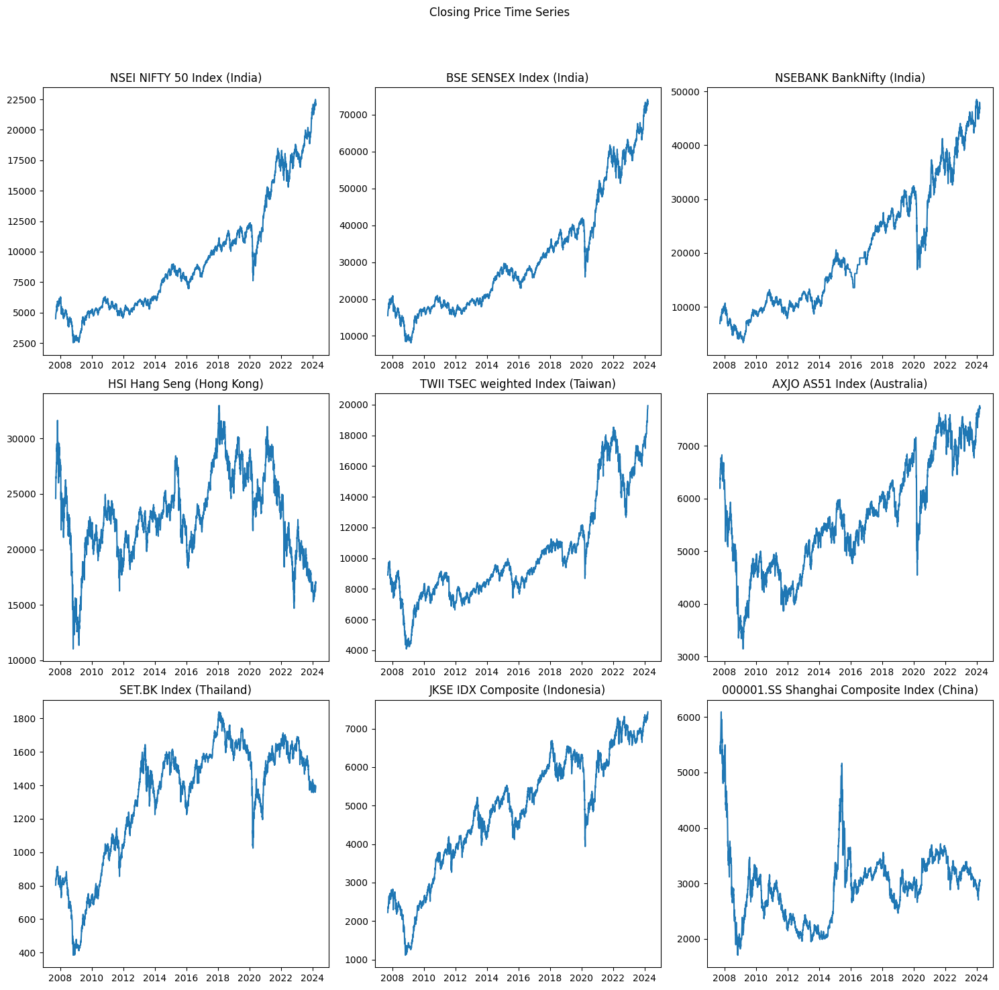

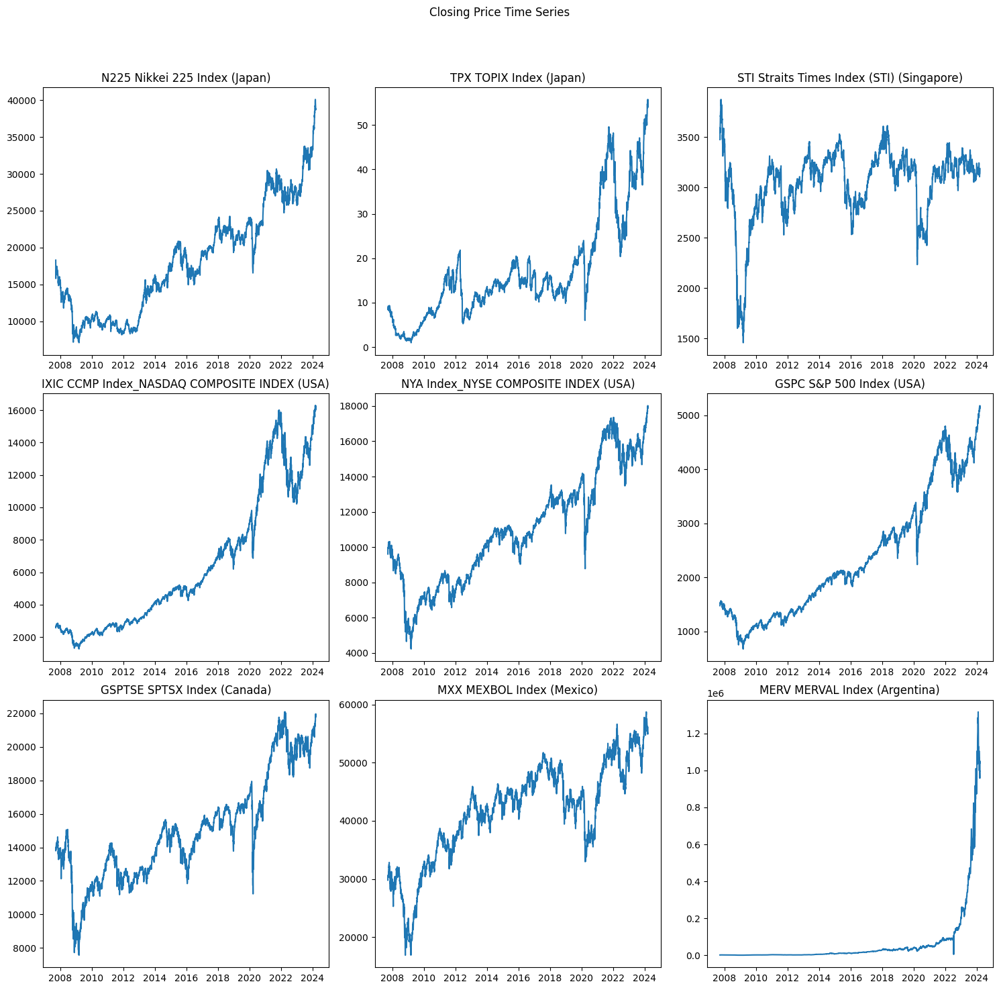

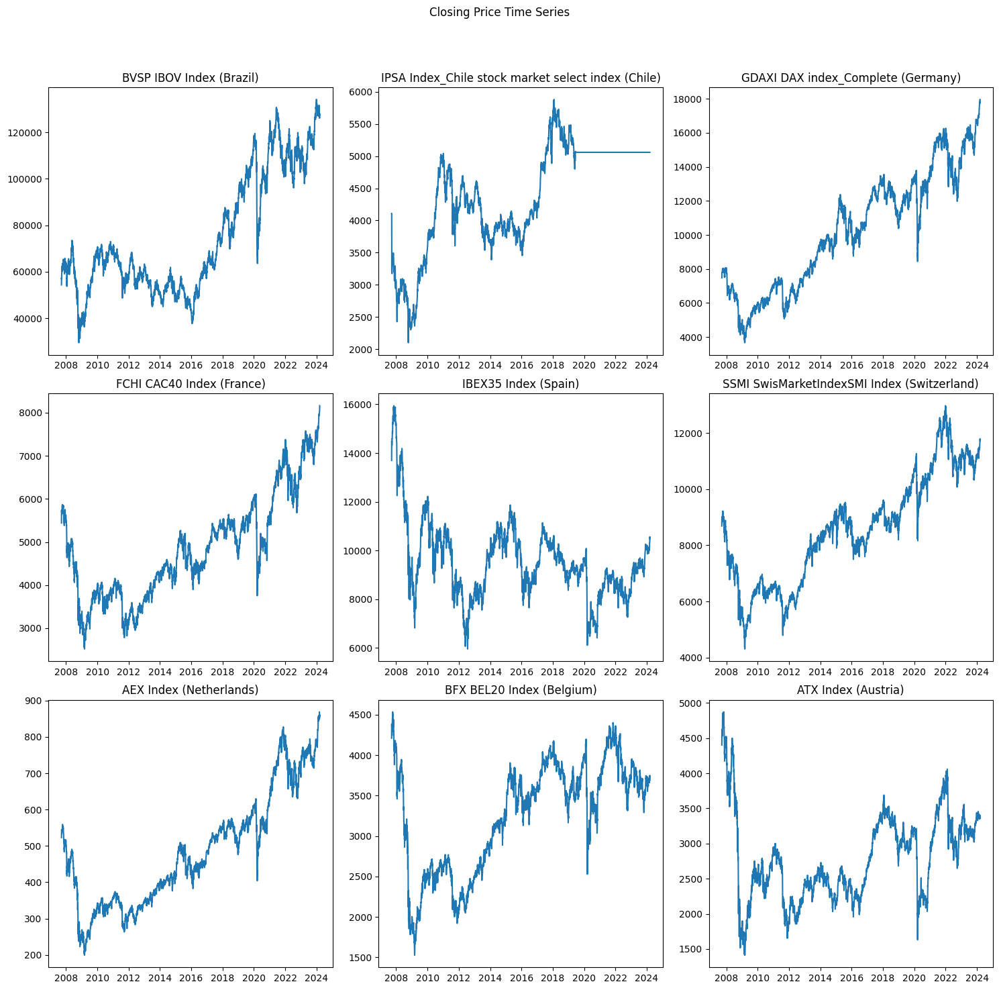

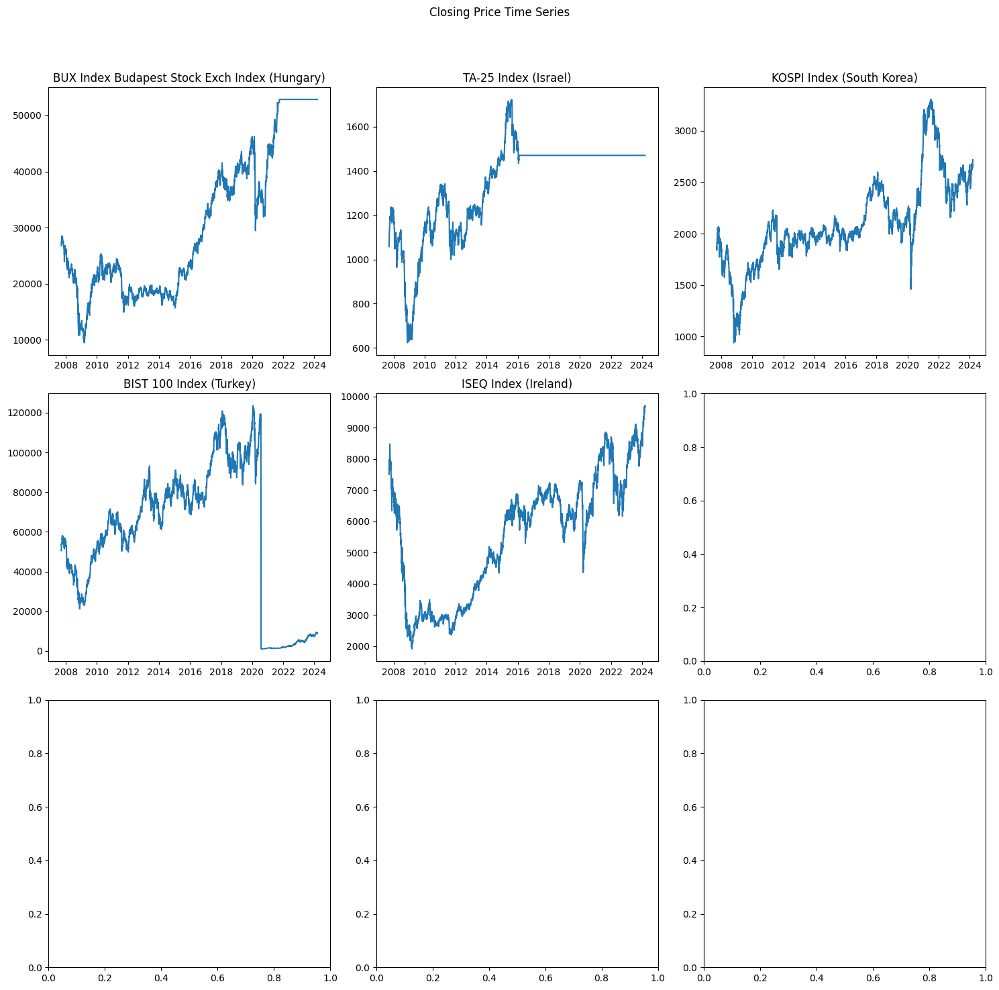

In [14]:
num_stocks = len(combined_data.columns)
num_groups = (num_stocks + 8) // 9

for group in range(num_groups):
    start_idx = group * 9
    end_idx = min(start_idx + 9, num_stocks)

    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    fig.suptitle("Closing Price Time Series")

    for i, ax in enumerate(axes.flatten()):
        if start_idx + i < end_idx:
            column_name = combined_data.columns[start_idx + i]
            stock_data = combined_data[column_name]
            ax.plot(stock_data.index, stock_data.values)
            ax.set_title(column_name)
            ax.xaxis_date()

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


In [ ]:
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

log_returns = np.log(data / data.shift(1))

In [ ]:
max_values = log_returns.max()
min_values = log_returns.min()
columns_to_keep = (max_values <= 0.8) & (min_values >= -0.8)
log_returns = log_returns.loc[:, columns_to_keep]

In [ ]:
log_returns.isnull().sum()

NSEI NIFTY 50 Index (India)                           1
BSE SENSEX Index (India)                              1
NSEBANK BankNifty (India)                             1
HSI Hang Seng (Hong Kong)                             1
TWII TSEC weighted Index (Taiwan)                     1
AXJO AS51 Index (Australia)                           1
SET.BK Index (Thailand)                               1
JKSE IDX Composite (Indonesia)                        1
000001.SS Shanghai Composite Index (China)            1
N225 Nikkei 225 Index (Japan)                         1
TPX TOPIX Index (Japan)                               1
STI Straits Times Index (STI) (Singapore)             1
IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)          1
NYA Index_NYSE COMPOSITE INDEX (USA)                  1
GSPC S&P 500 Index (USA)                              1
GSPTSE SPTSX Index (Canada)                           1
MXX MEXBOL Index (Mexico)                             1
BVSP IBOV Index (Brazil)                        

In [ ]:
log_returns = log_returns.dropna(thresh=log_returns.shape[1] - 2)
log_returns = log_returns.dropna(axis=1, thresh=log_returns.shape[0] - 2)

In [ ]:
log_returns.isnull().sum()

NSEI NIFTY 50 Index (India)                           0
BSE SENSEX Index (India)                              0
NSEBANK BankNifty (India)                             0
HSI Hang Seng (Hong Kong)                             0
TWII TSEC weighted Index (Taiwan)                     0
AXJO AS51 Index (Australia)                           0
SET.BK Index (Thailand)                               0
JKSE IDX Composite (Indonesia)                        0
000001.SS Shanghai Composite Index (China)            0
N225 Nikkei 225 Index (Japan)                         0
TPX TOPIX Index (Japan)                               0
STI Straits Times Index (STI) (Singapore)             0
IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)          0
NYA Index_NYSE COMPOSITE INDEX (USA)                  0
GSPC S&P 500 Index (USA)                              0
GSPTSE SPTSX Index (Canada)                           0
MXX MEXBOL Index (Mexico)                             0
BVSP IBOV Index (Brazil)                        

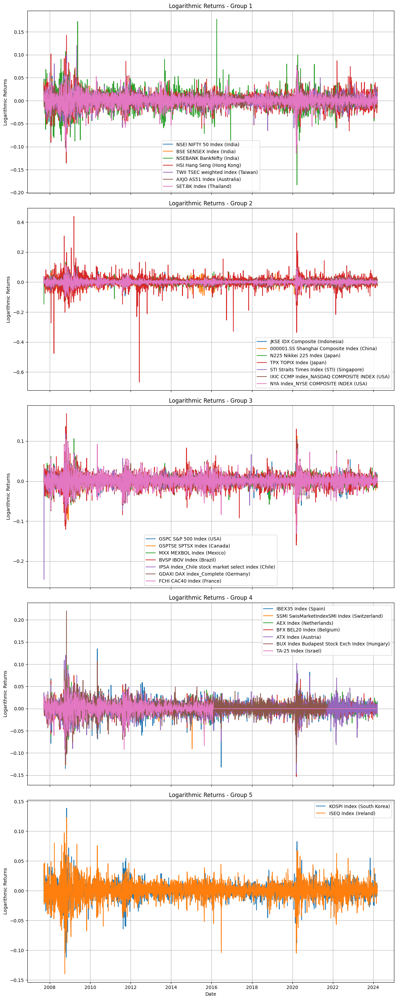

In [ ]:
#@title Plot all the log return-time series [r(t)=lnP(t)-lnP(t-1)] in 3X3 subplots
stocks_per_group = 7

num_groups = (len(log_returns.columns) + stocks_per_group - 1) // stocks_per_group

fig, axes = plt.subplots(num_groups, figsize=(12, 6*num_groups), sharex=True)

for i in range(num_groups):
    start_idx = i * stocks_per_group
    end_idx = (i + 1) * stocks_per_group
    group_columns = log_returns.columns[start_idx:end_idx]

    if end_idx > len(log_returns.columns):
        end_idx = len(log_returns.columns)
        group_columns = log_returns.columns[start_idx:end_idx]

    selected_data = log_returns[group_columns]

    for stock_symbol in selected_data.columns:
        axes[i].plot(selected_data.index, selected_data[stock_symbol], label=stock_symbol)

    axes[i].set_title(f'Logarithmic Returns - Group {i+1}')
    axes[i].set_ylabel('Logarithmic Returns')
    axes[i].legend()
    axes[i].grid(True)

axes[-1].set_xlabel('Date')

plt.tight_layout()
plt.show()

In [ ]:
index_mapping = {
    'NSEI NIFTY 50 Index (India)': 'NSEI',
    'BSE SENSEX Index (India)': 'BSE',
    'NSEBANK BankNifty (India)': 'BANKNIFTY',
    'HSI Hang Seng (Hong Kong)': 'HSI',
    'TWII TSEC weighted Index (Taiwan)': 'TWII',
    'AXJO AS51 Index (Australia)': 'AXJO',
    'SET.BK Index (Thailand)': 'SET',
    'JKSE IDX Composite (Indonesia)': 'JKSE',
    '000001.SS Shanghai Composite Index (China)': '000001.SS',
    'N225 Nikkei 225 Index (Japan)': 'N225',
    'TPX TOPIX Index (Japan)': 'TPX',
    'STI Straits Times Index (STI) (Singapore)': 'STI',
    'IXIC CCMP Index_NASDAQ COMPOSITE INDEX (USA)': 'IXIC',
    'NYA Index_NYSE COMPOSITE INDEX (USA)': 'NYA',
    'GSPC S&P 500 Index (USA)': 'GSPC',
    'GSPTSE SPTSX Index (Canada)': 'GSPTSE',
    'MXX MEXBOL Index (Mexico)': 'MXX',
    'BVSP IBOV Index (Brazil)': 'BVSP',
    'IPSA Index_Chile stock market select index (Chile)': 'IPSA',
    'GDAXI DAX index_Complete (Germany)': 'GDAXI',
    'FCHI CAC40 Index (France)': 'FCHI',
    'IBEX35 Index (Spain)': 'IBEX35',
    'SSMI SwisMarketIndexSMI Index (Switzerland)': 'SSMI',
    'AEX Index (Netherlands)': 'AEX',
    'BFX BEL20 Index (Belgium)': 'BFX',
    'ATX Index (Austria)': 'ATX',
    'BUX Index Budapest Stock Exch Index (Hungary)': 'BUX',
    'TA-25 Index (Israel)': 'TA-25',
    'KOSPI Index (South Korea)': 'KOSPI',
    'ISEQ Index (Ireland)': 'ISEQ'
}


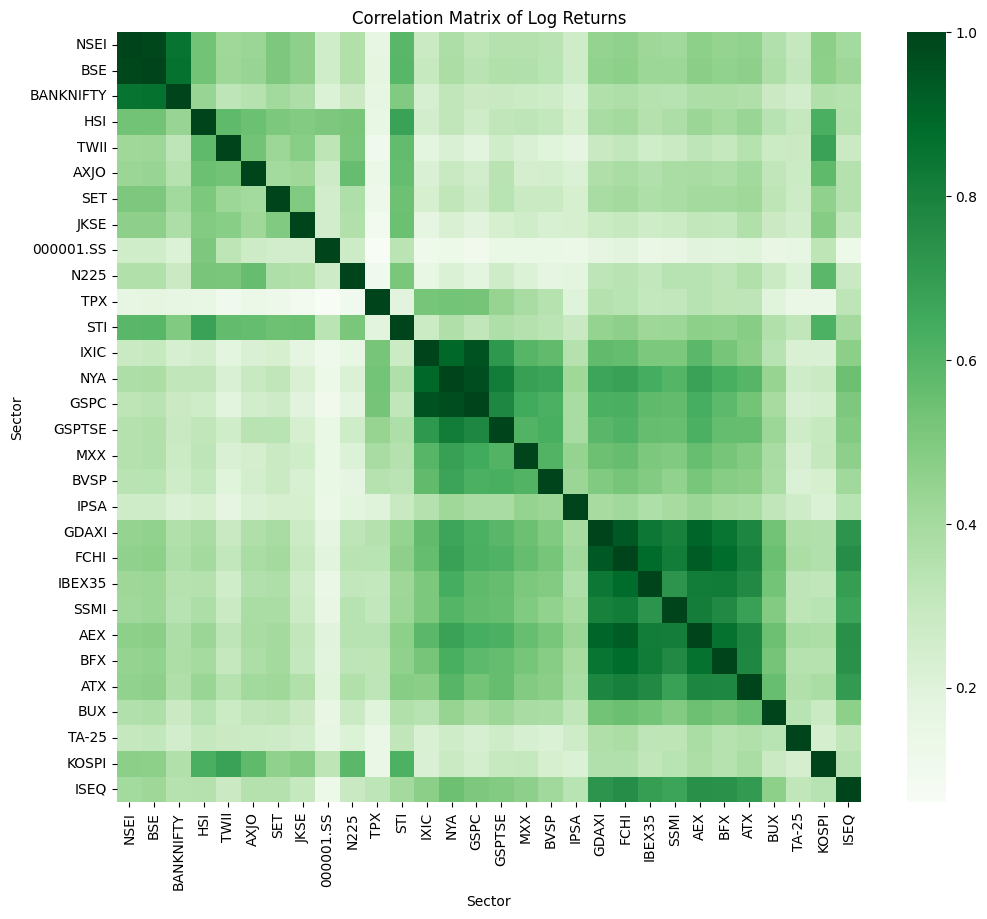

In [ ]:
def plot_correlation_matrix(log_returns, title="Correlation Matrix"):
    correlation_matrix = log_returns.corr()

    short_forms = log_returns.columns.map(index_mapping)

    plt.figure(figsize=(12, 10))
    sns.heatmap(correlation_matrix, cmap="Greens", annot=False, fmt=".2f", xticklabels=short_forms, yticklabels=short_forms)
    plt.title(title)
    plt.xlabel("Sector")
    plt.ylabel("Sector")
    plt.show()

plot_correlation_matrix(log_returns, title="Correlation Matrix of Log Returns")

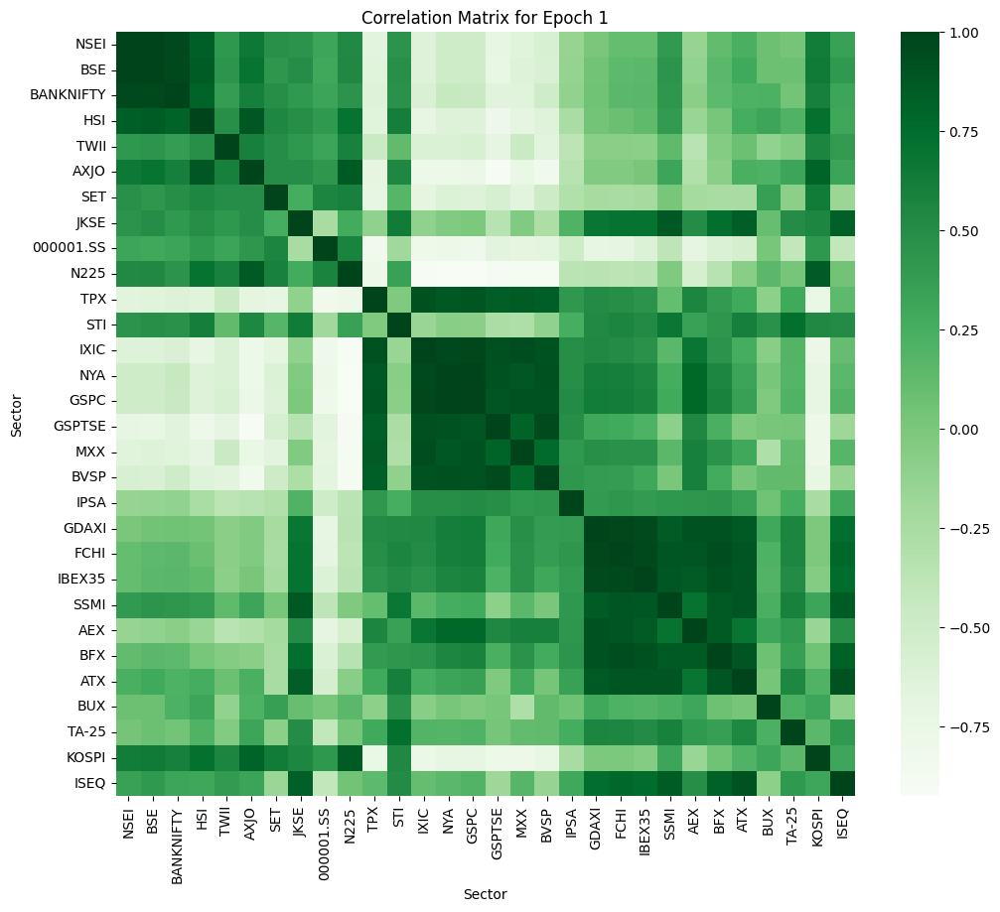

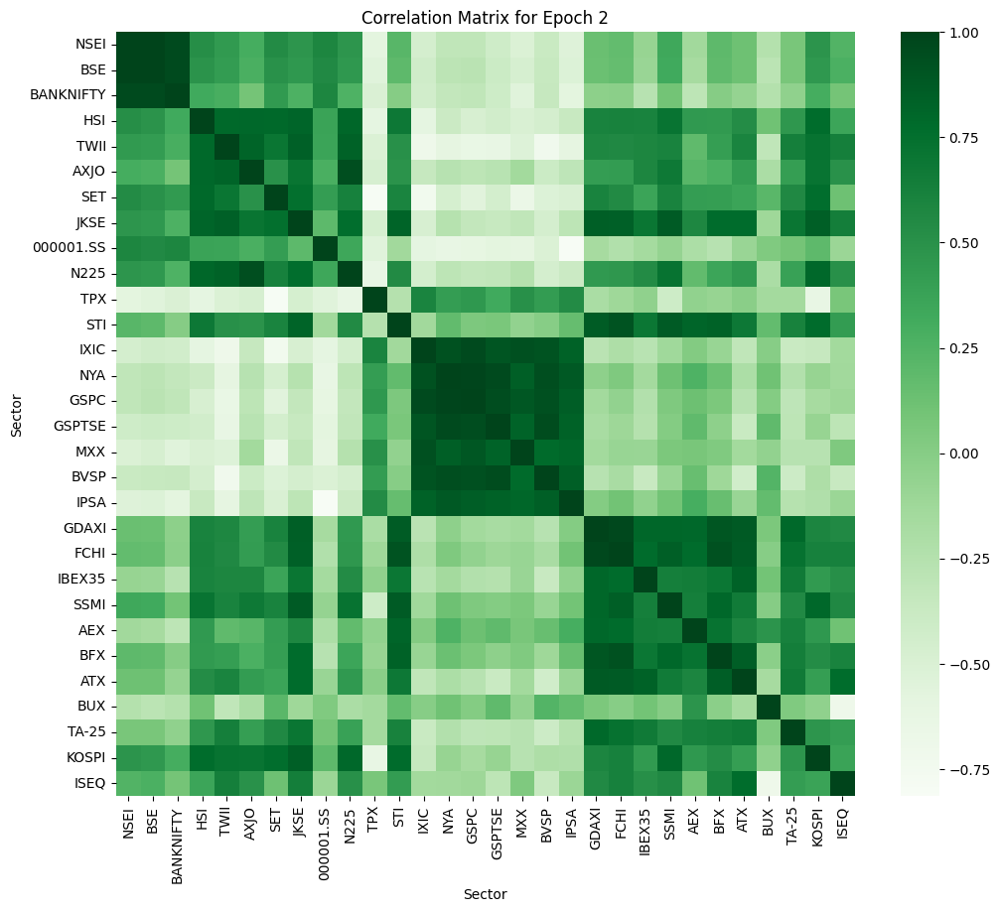

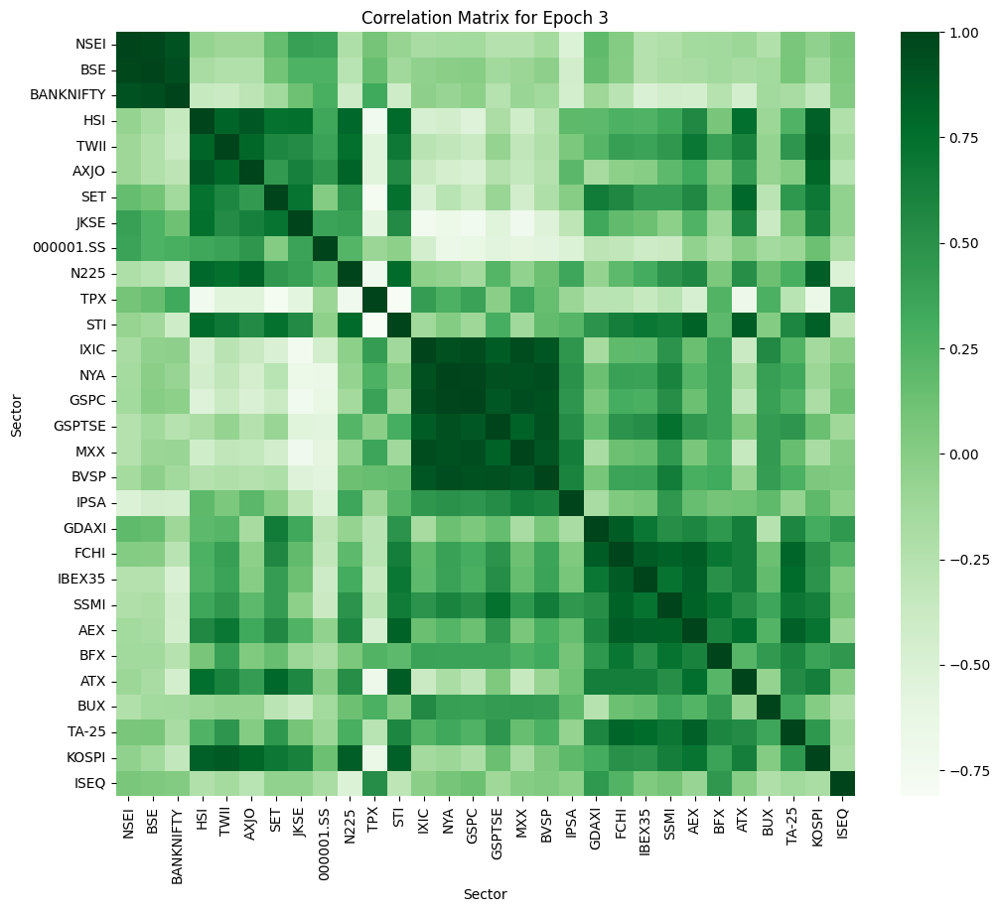

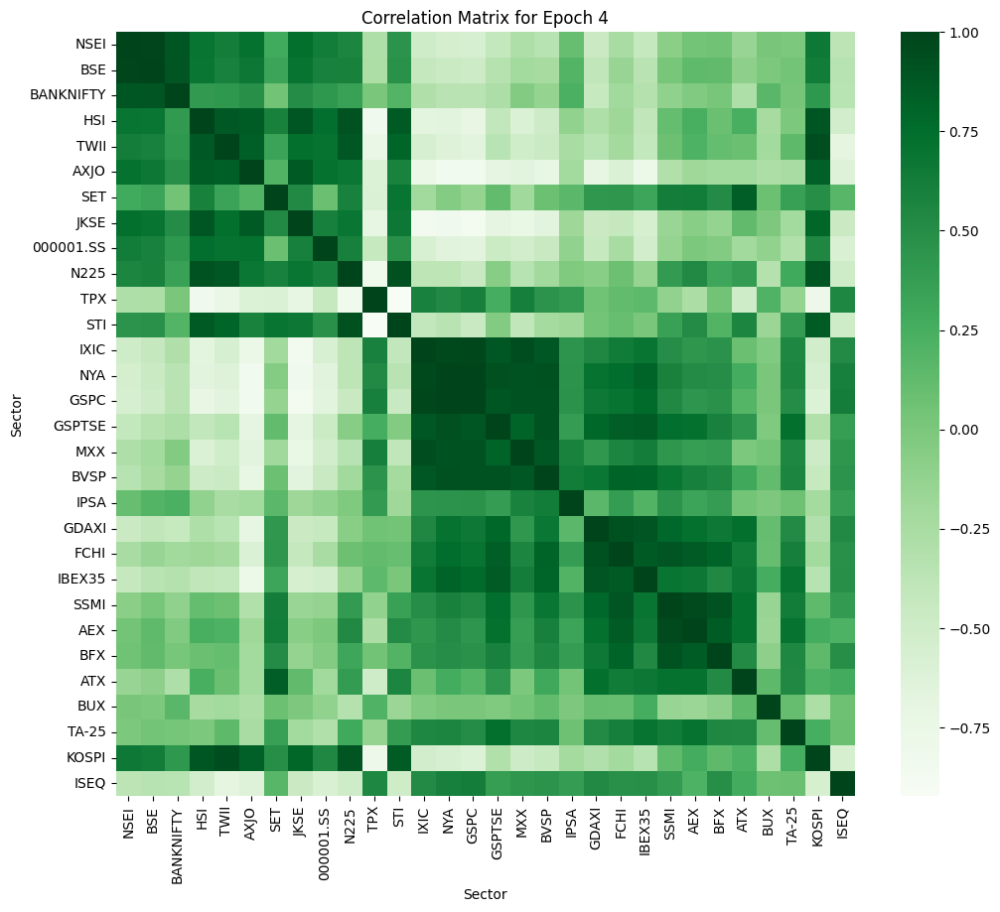

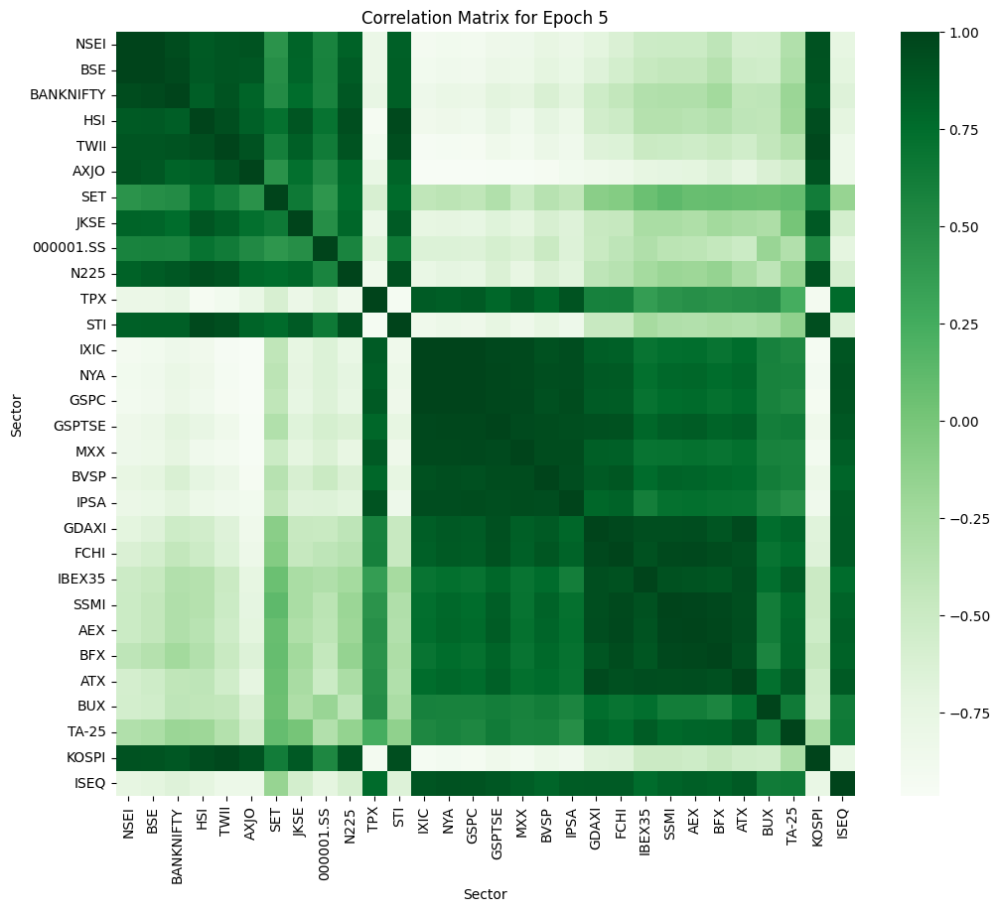

...

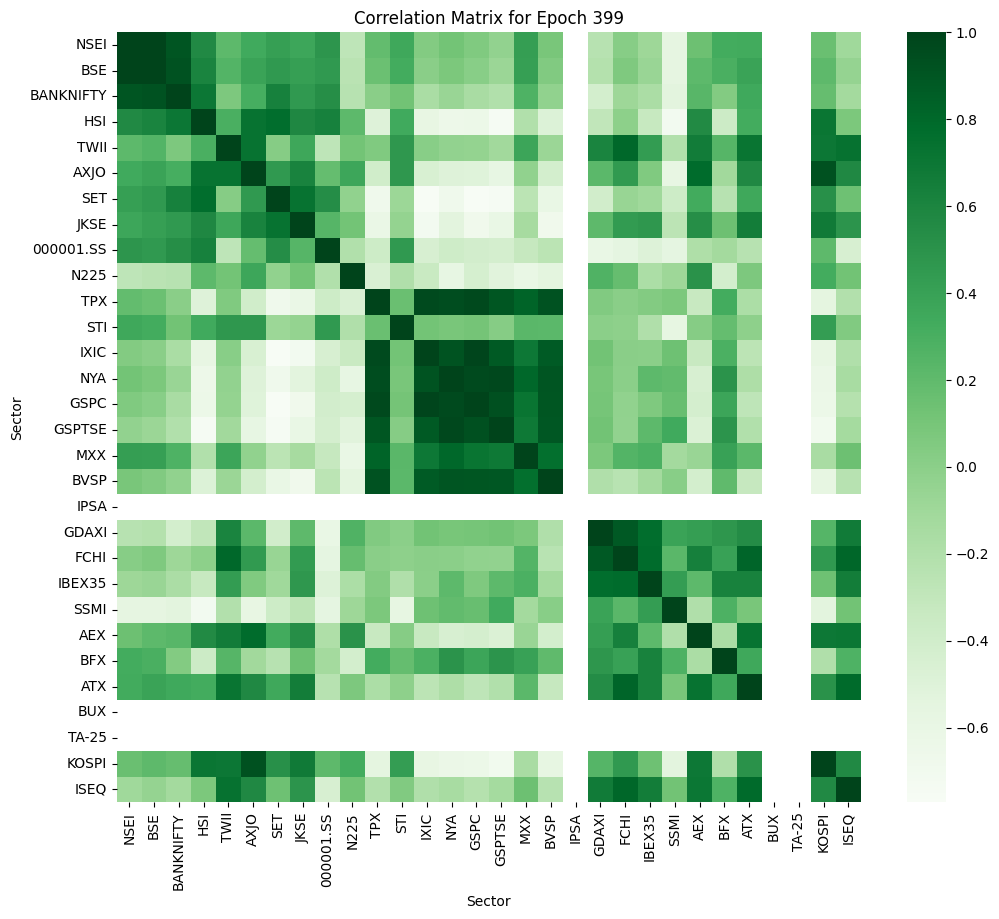

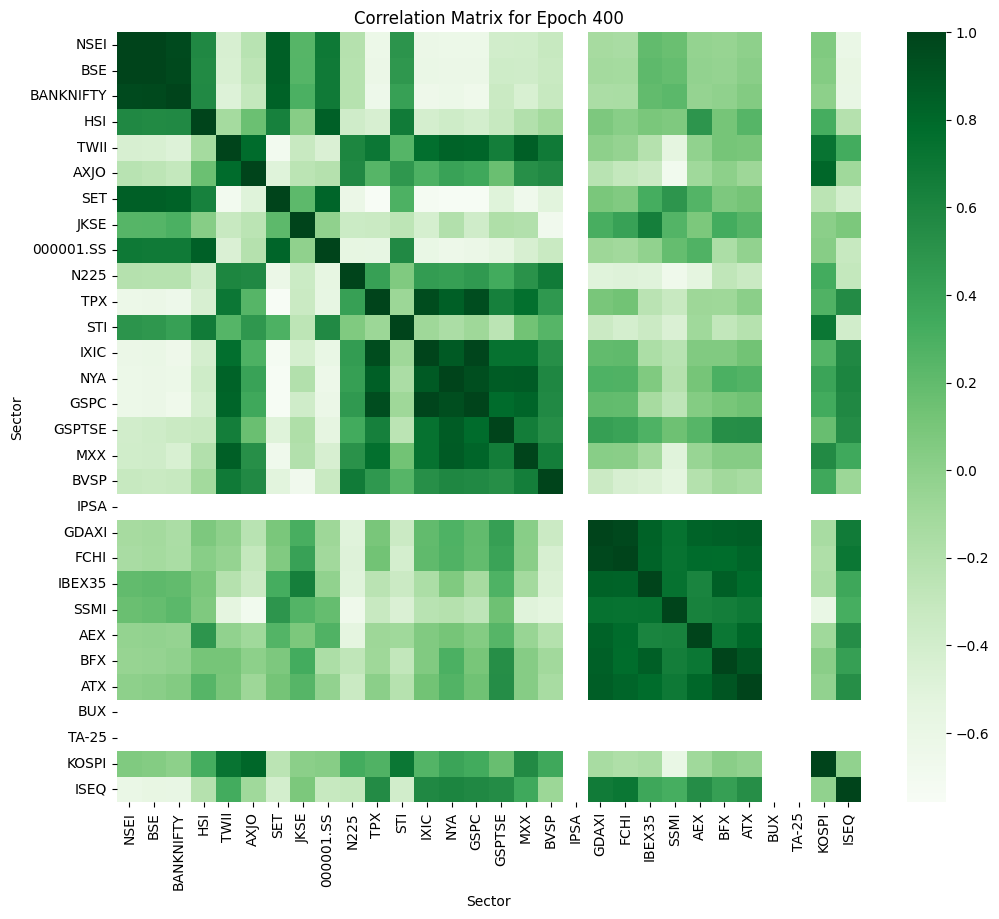

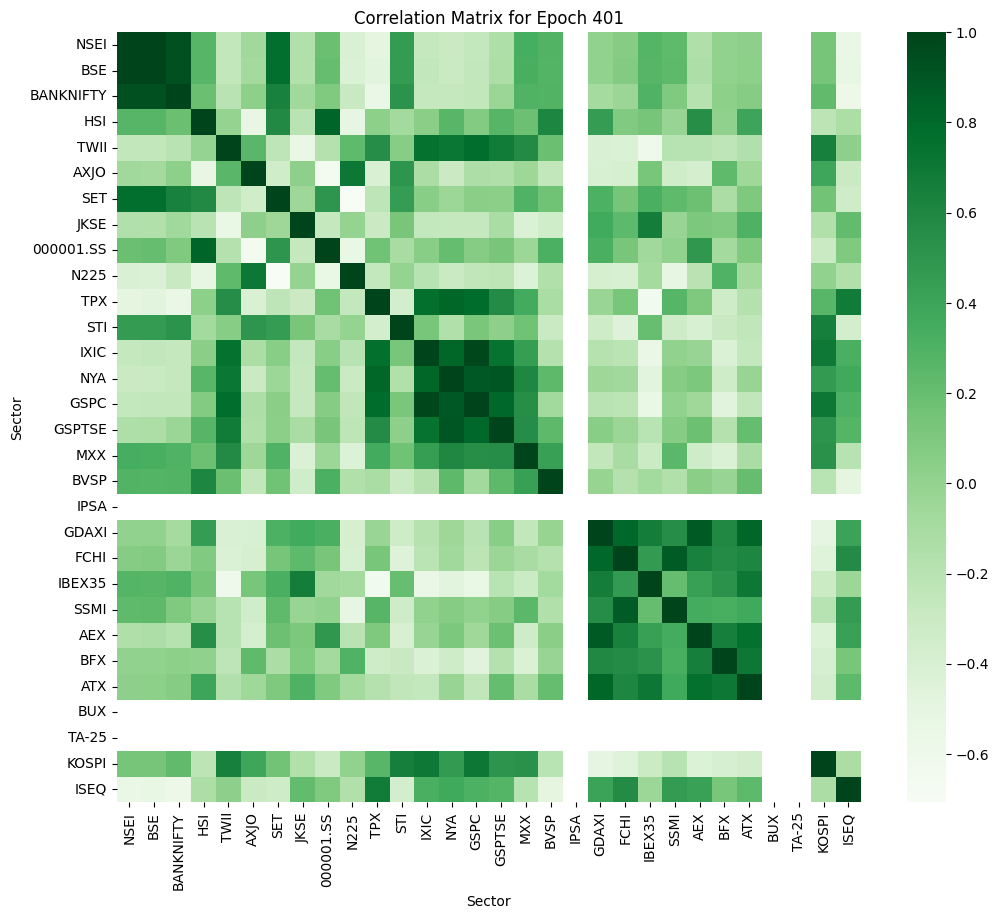

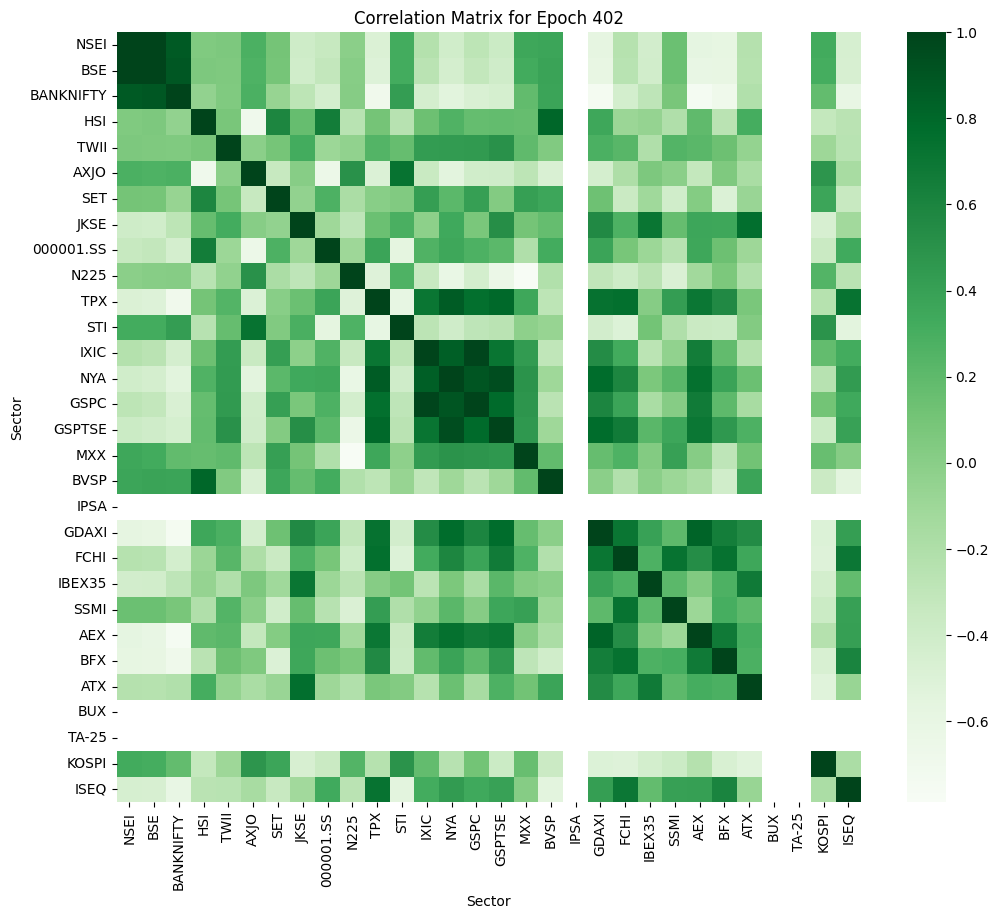

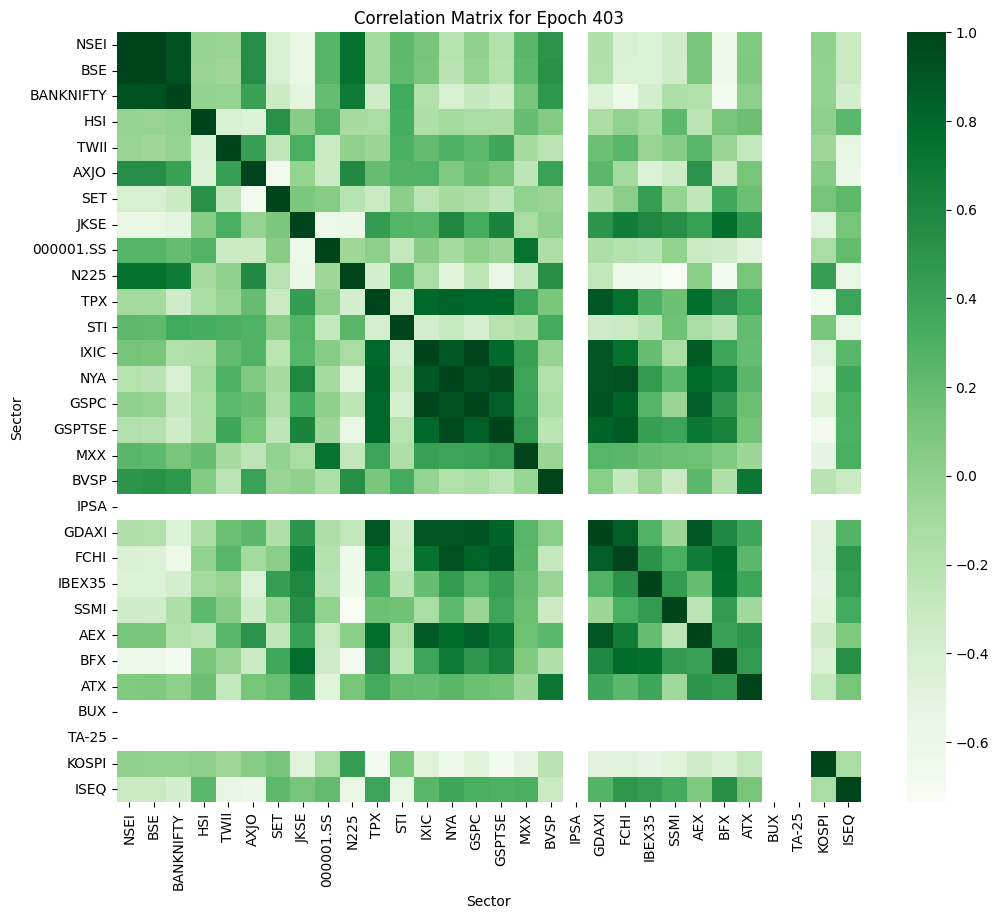

In [ ]:
epoch_size = 20
shift = 10

correlation_matrices = []

for i in range(0, len(log_returns) - epoch_size, shift):
    subset = log_returns.iloc[i:i + epoch_size]
    correlation_matrix = subset.corr()
    correlation_matrices.append(correlation_matrix)

for i, correlation_matrix in enumerate(correlation_matrices):
    title = f"Correlation Matrix for Epoch {i+1}"
    plot_correlation_matrix(correlation_matrix, title)


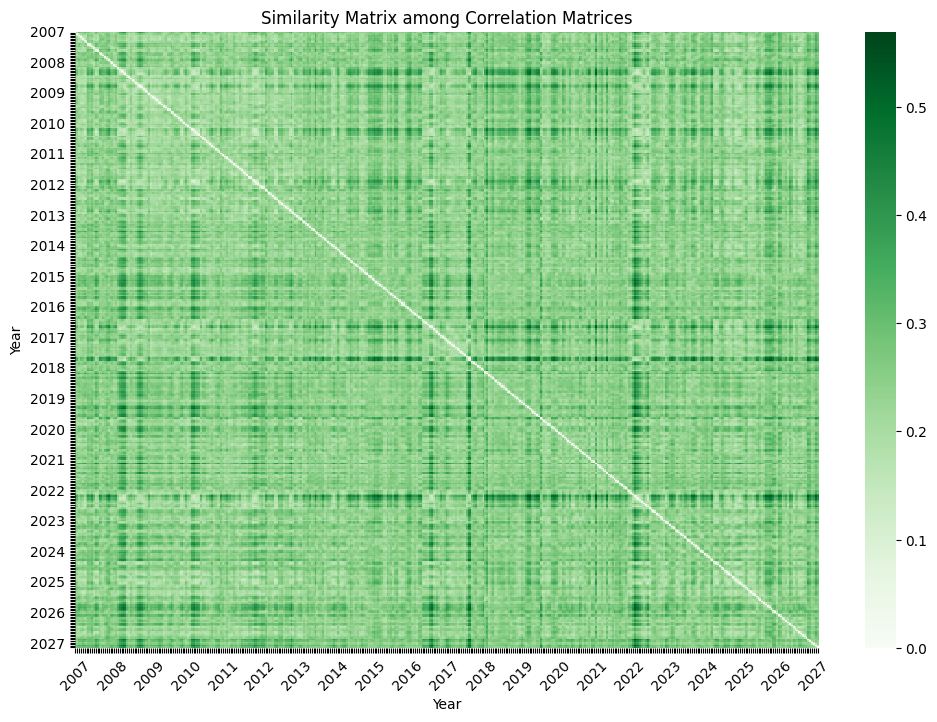

In [ ]:
def calculate_similarity_matrix(matrix1, matrix2):
    absolute_difference = np.abs(matrix1 - matrix2)
    similarity = absolute_difference.mean().mean()
    return similarity

num_matrices = len(correlation_matrices)
epochs_per_year = 20
years = range(2007, 2024)

similarity_matrix = np.zeros((num_matrices, num_matrices))

for i in range(num_matrices):
    for j in range(num_matrices):
        similarity_matrix[i, j] = calculate_similarity_matrix(correlation_matrices[i], correlation_matrices[j])

axis_labels = []
current_year = 2007
for i in range(num_matrices):
    if i % epochs_per_year == 0:
        axis_labels.append(current_year)
        current_year += 1
    else:
        axis_labels.append("")

plt.figure(figsize=(12, 8))
sns.heatmap(similarity_matrix, cmap="Greens", annot=False)
plt.title("Similarity Matrix among Correlation Matrices")
plt.xlabel("Year")
plt.ylabel("Year")
plt.xticks(np.arange(0.5, num_matrices + 0.5), axis_labels, rotation=45)
plt.yticks(np.arange(0.5, num_matrices + 0.5), axis_labels)
plt.show()


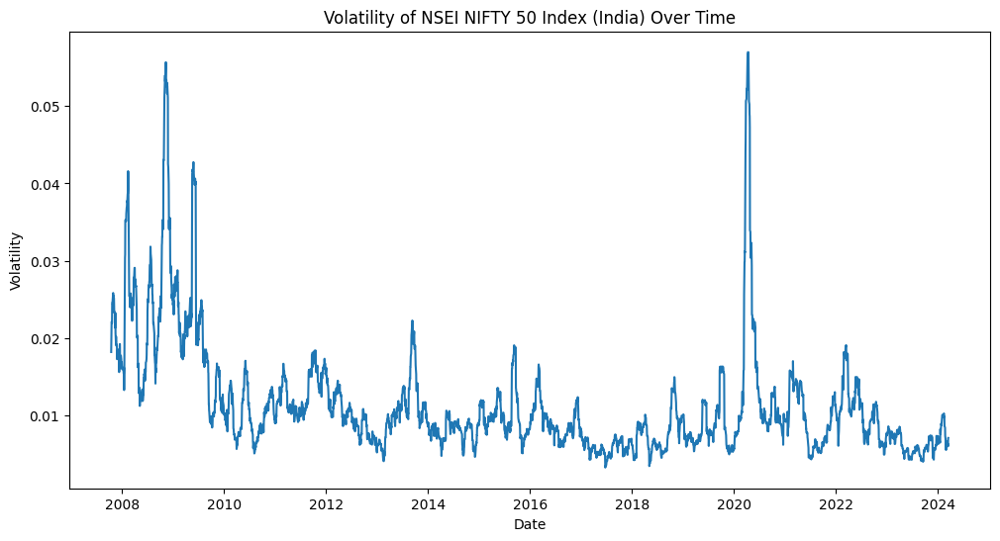

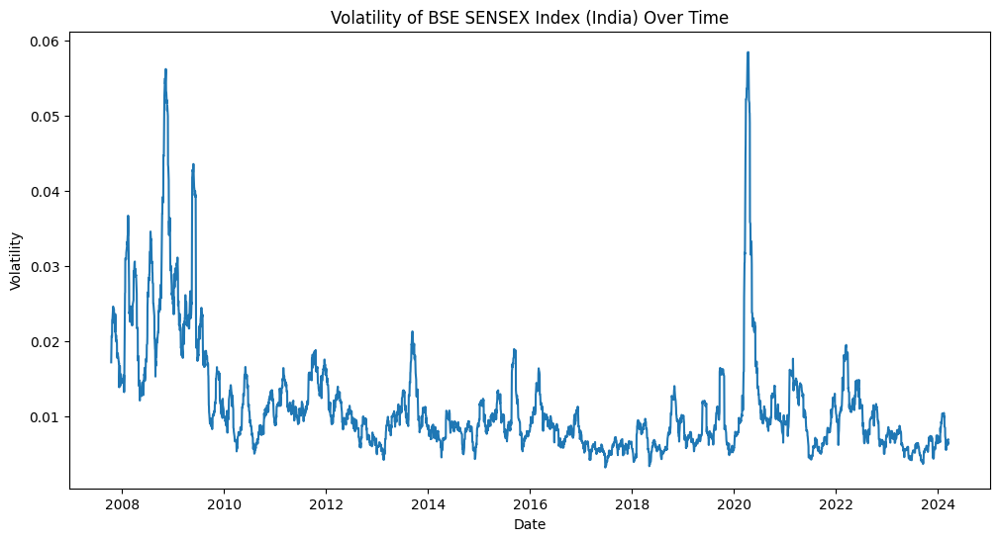

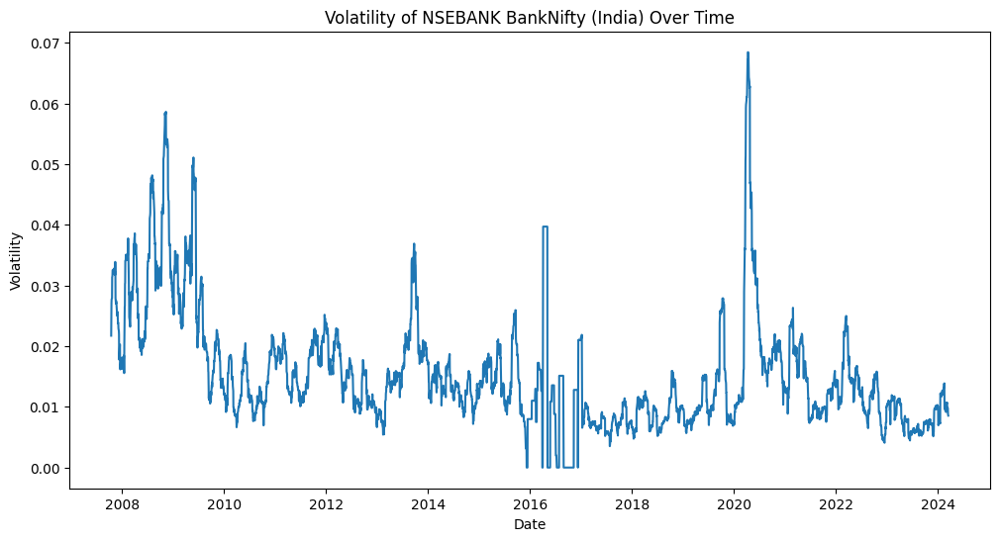

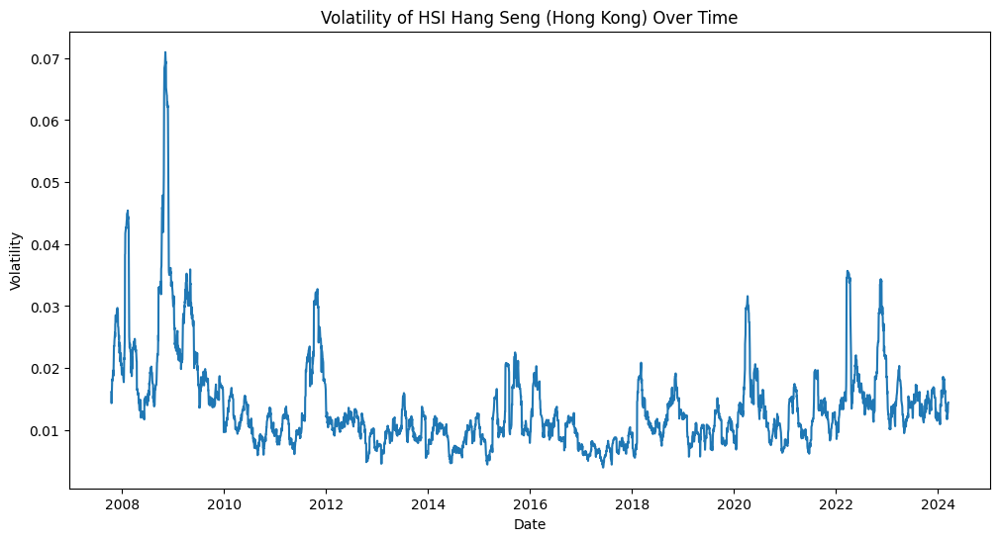

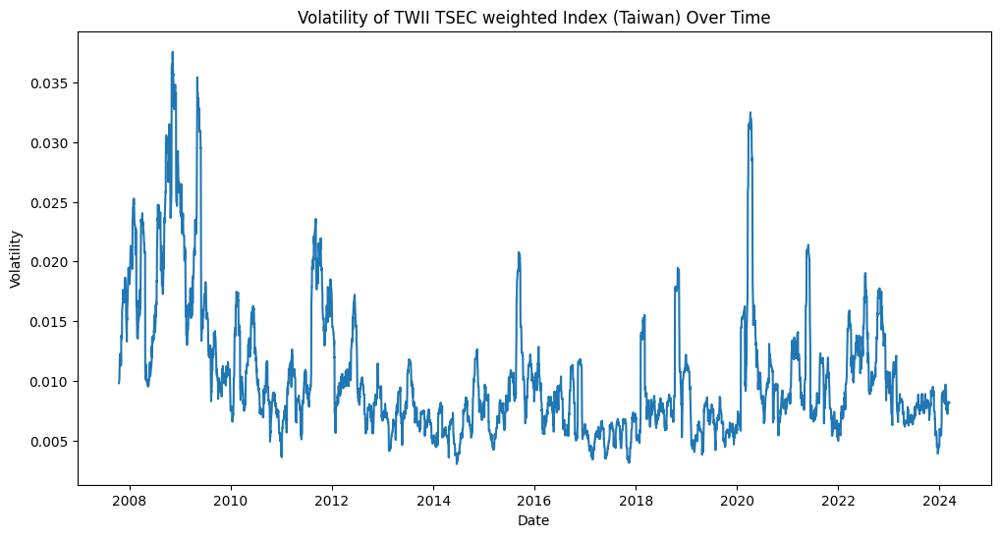

...

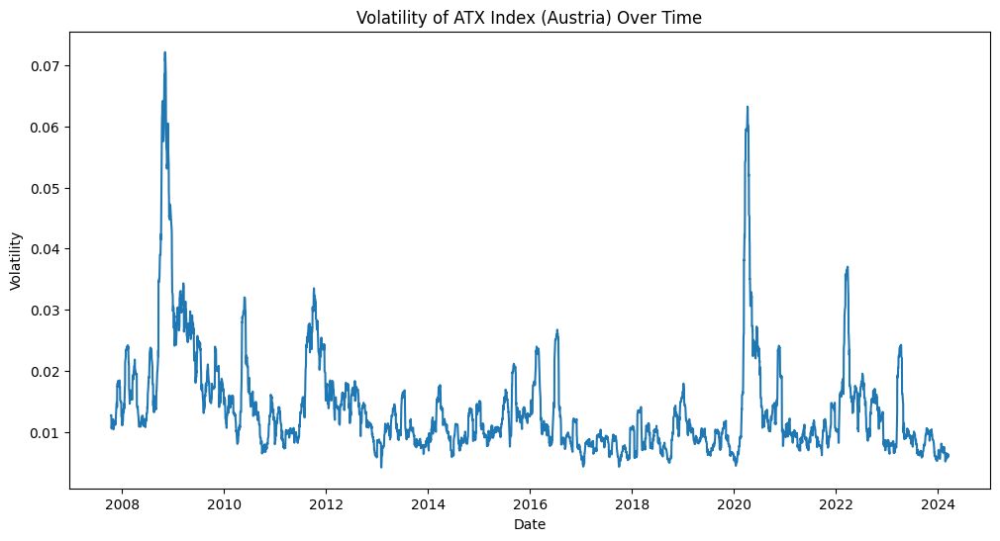

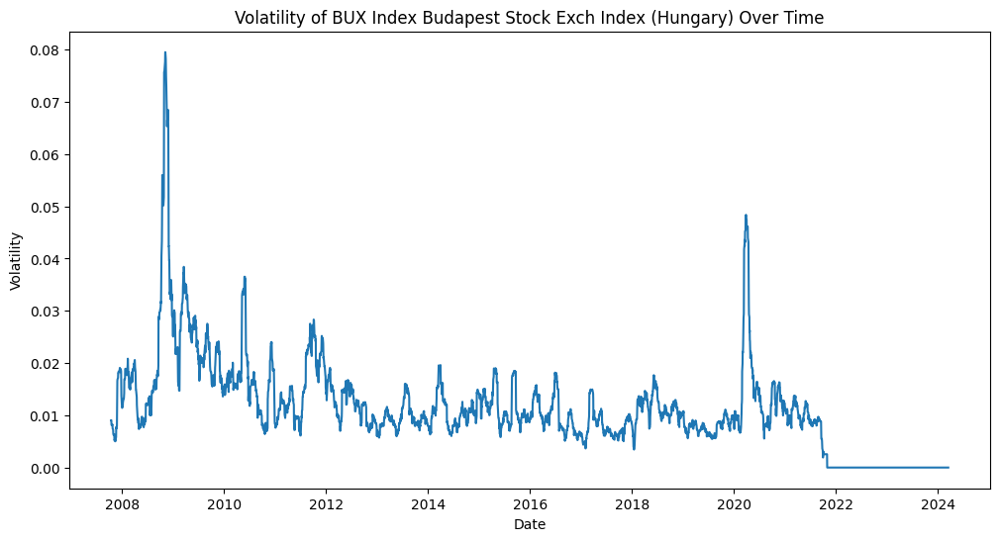

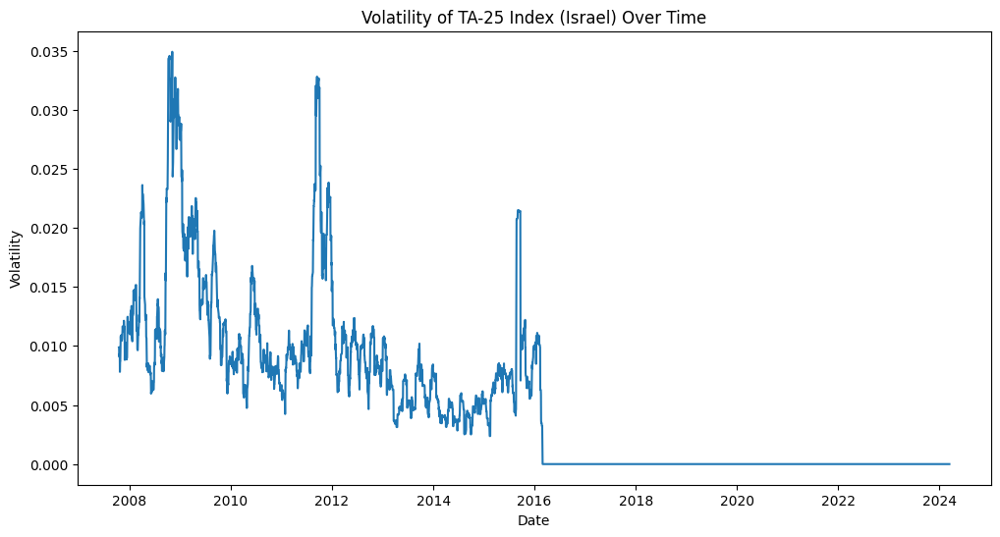

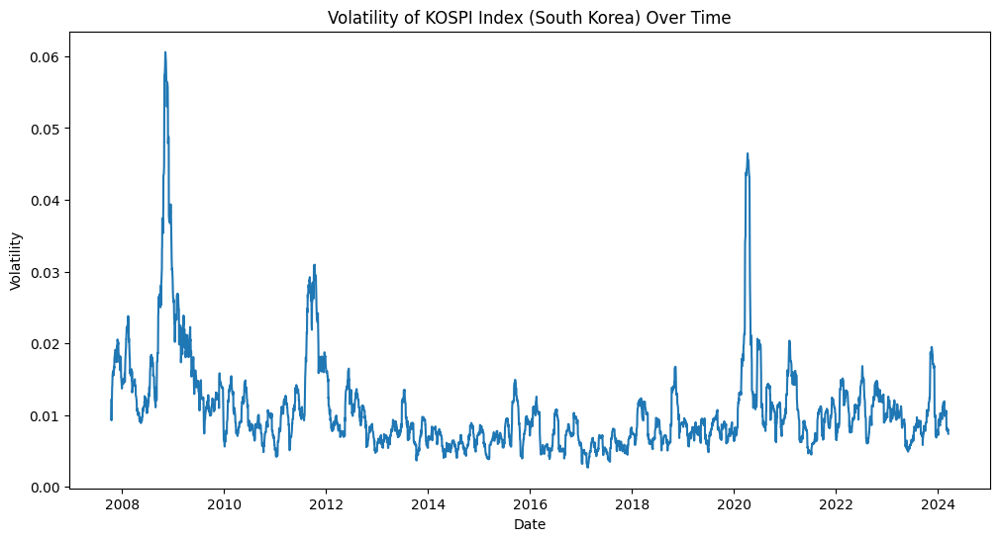

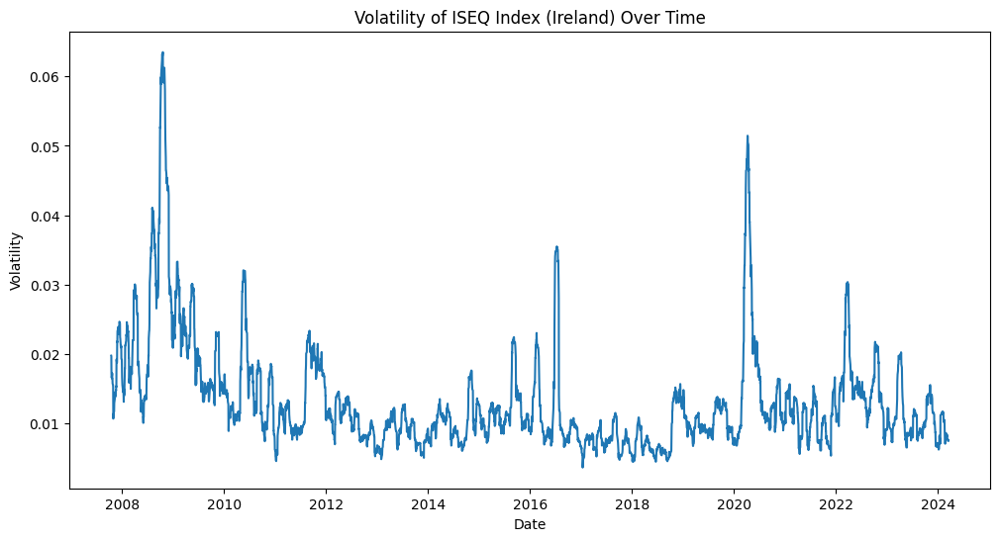

In [ ]:
rolling_volatility = log_returns.rolling(window=20).std()

for column in rolling_volatility.columns:
    plt.figure(figsize=(12, 6))
    plt.plot(rolling_volatility.index, rolling_volatility[column])
    plt.title(f'Volatility of {column} Over Time')
    plt.xlabel('Date')
    plt.ylabel('Volatility')

    plt.show()

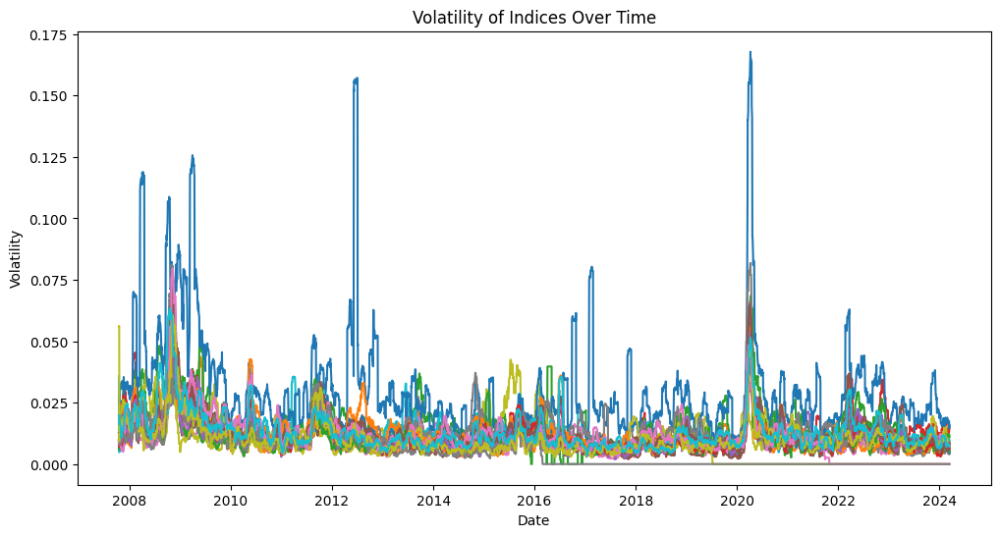

In [ ]:
plt.figure(figsize=(12, 6))
for column in rolling_volatility.columns:
    plt.plot(rolling_volatility.index, rolling_volatility[column], label=column)

plt.title('Volatility of Indices Over Time')
plt.xlabel('Date')
plt.ylabel('Volatility')


plt.show()

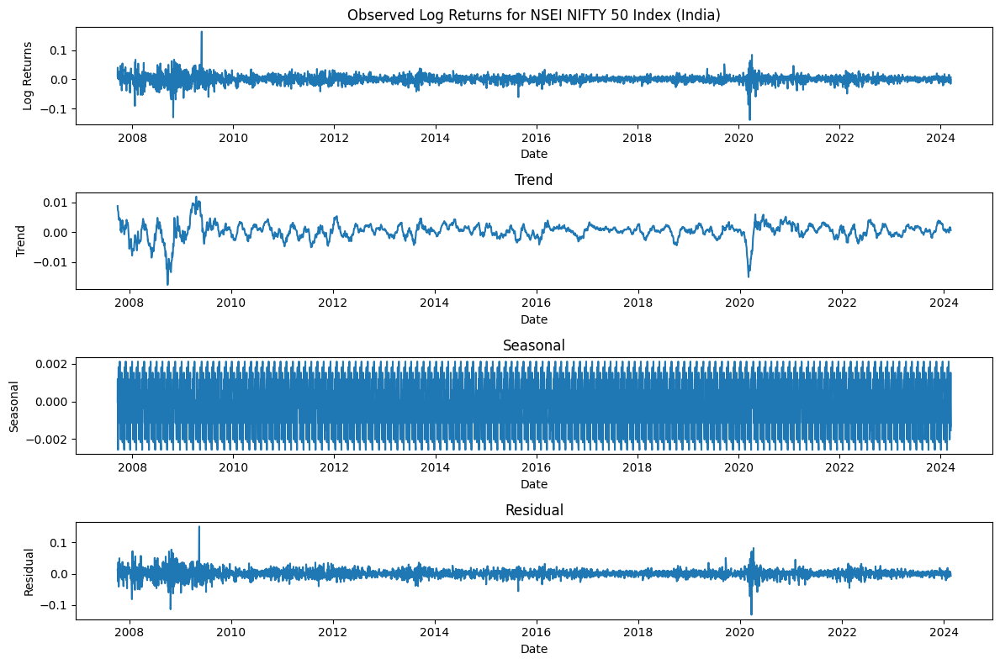

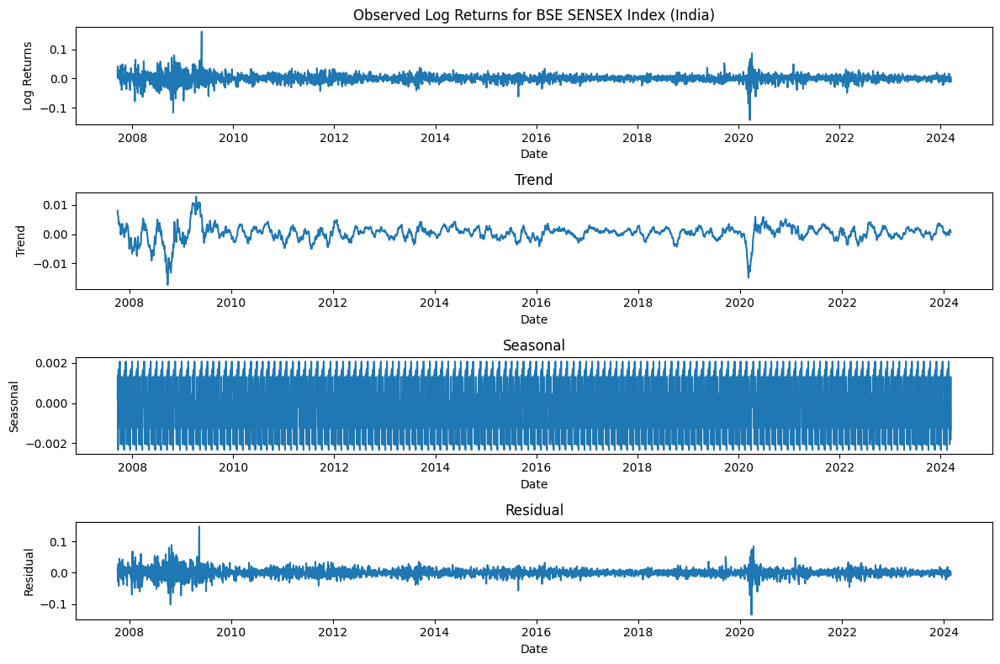

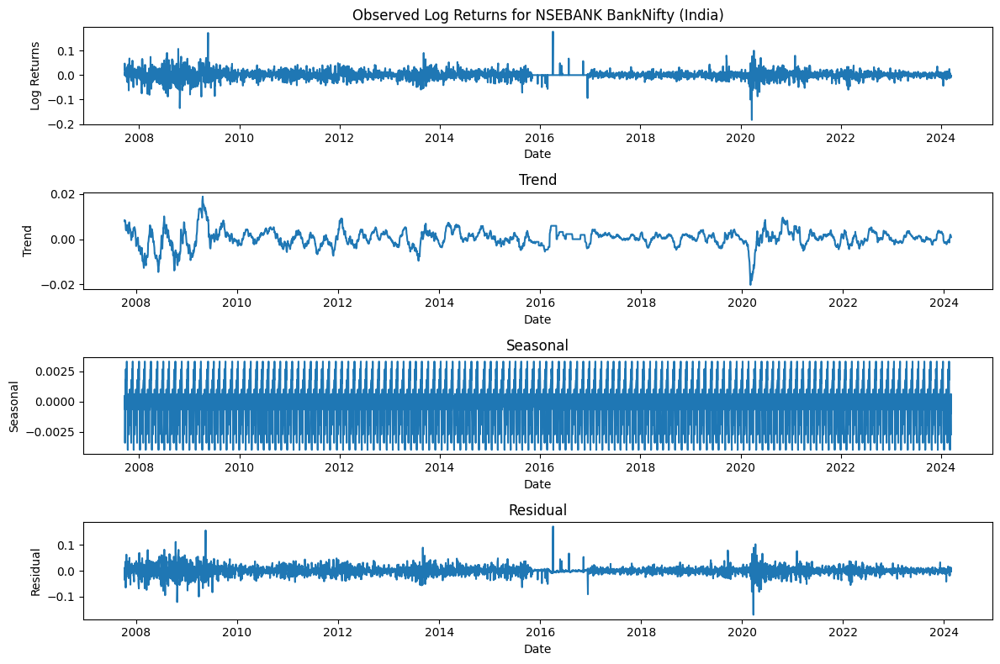

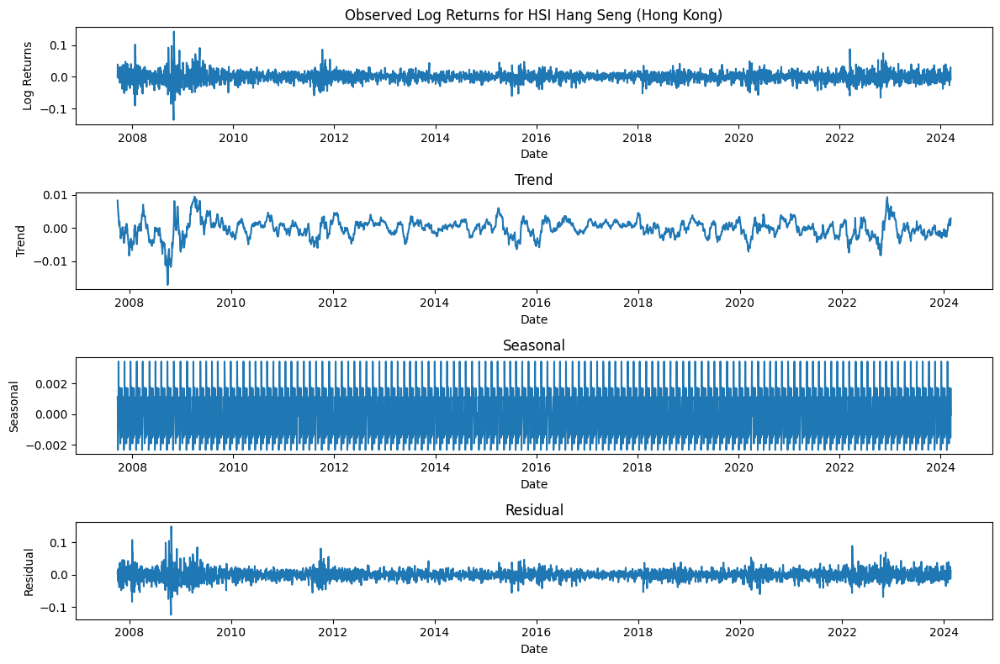

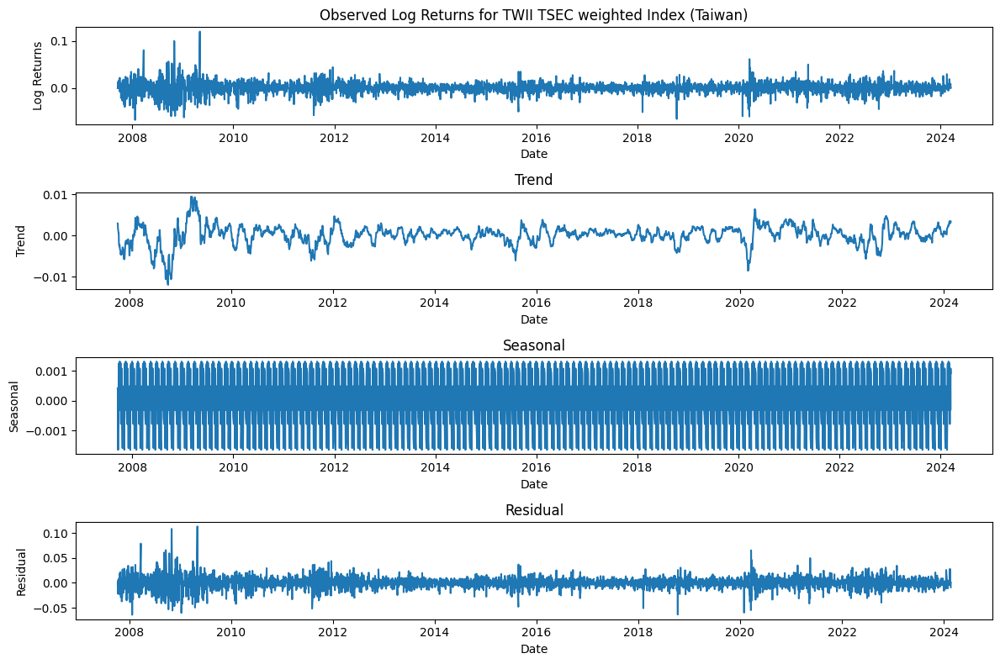

...

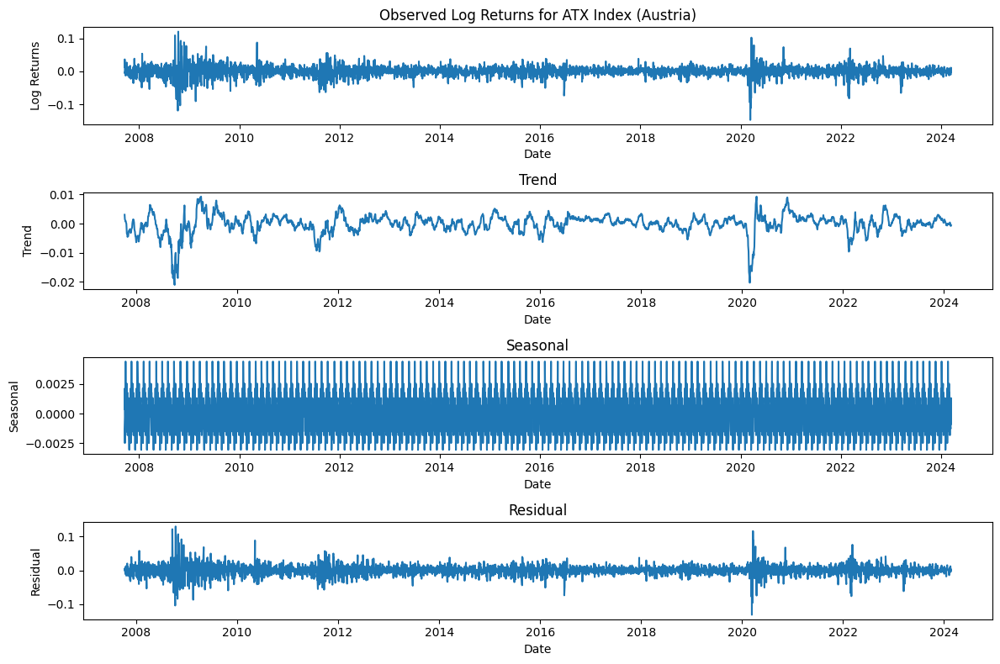

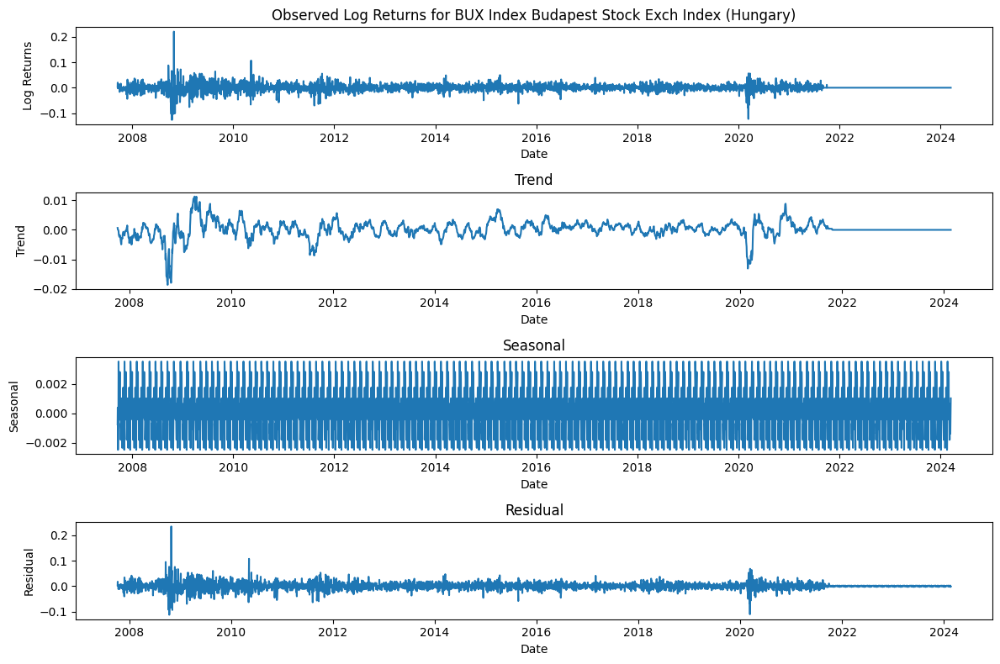

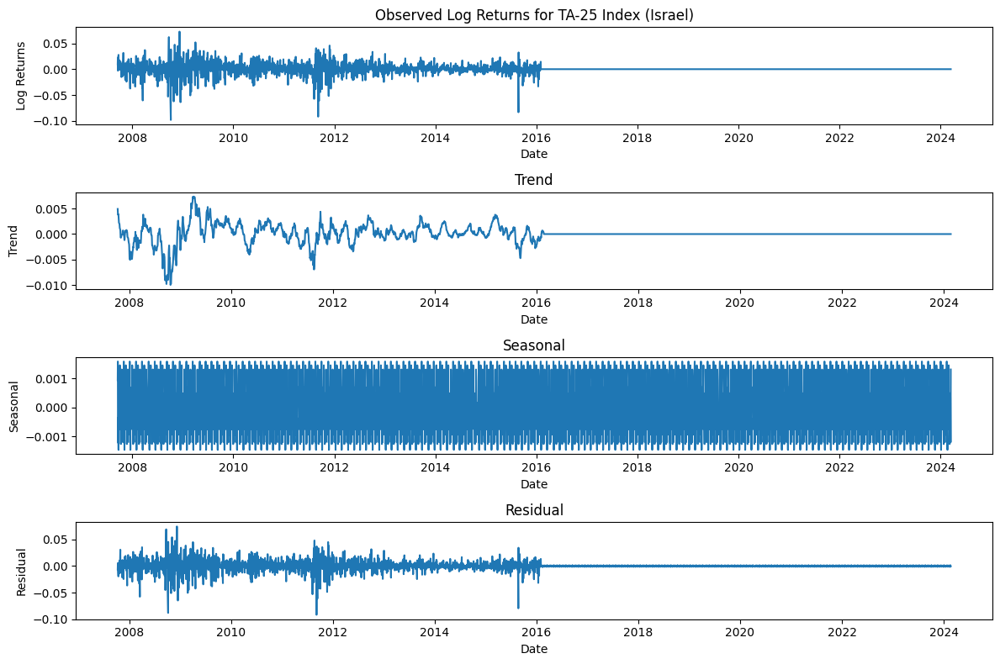

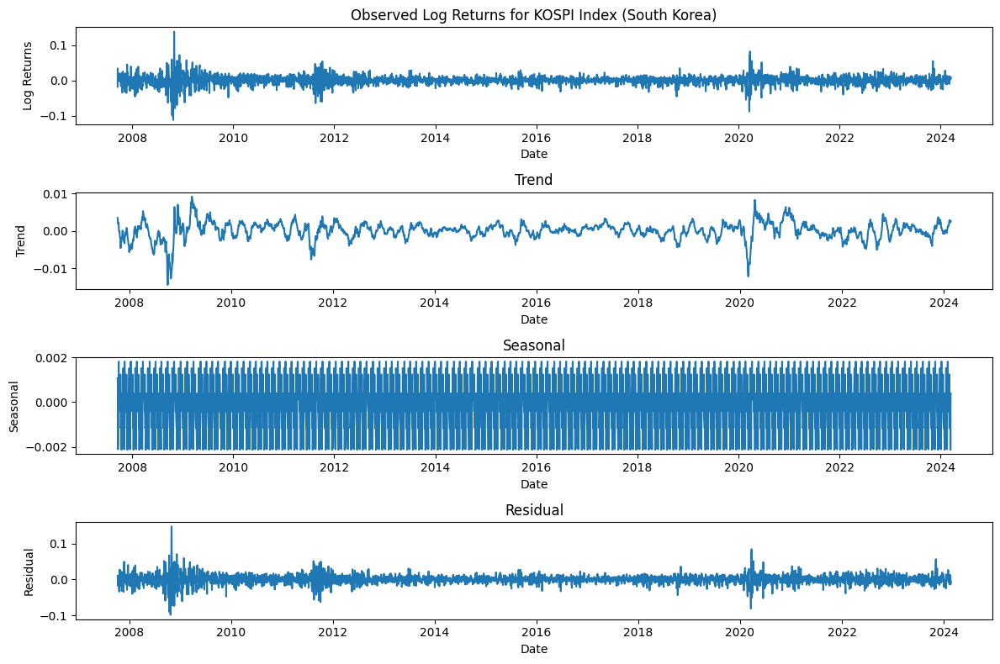

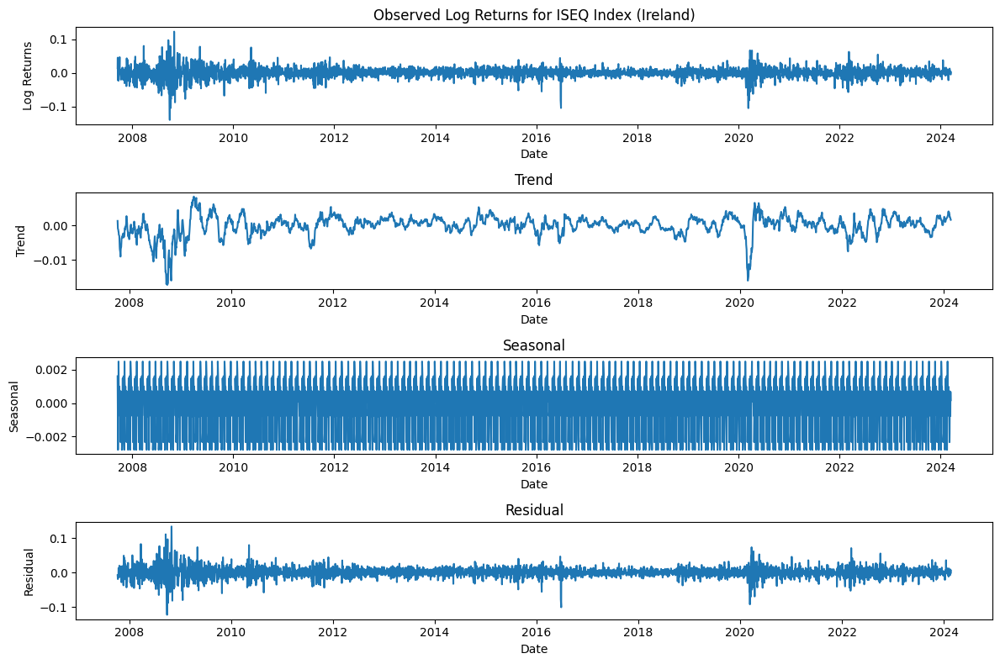

In [ ]:
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Assuming log_returns is your DataFrame containing log returns

# Perform seasonal decomposition for each index
for column in log_returns.columns:
    decomposition = seasonal_decompose(log_returns[column], model='additive', period=30)  # Adjust period as needed

    # Plot the decomposed components
    plt.figure(figsize=(12, 8))
    plt.subplot(4, 1, 1)
    plt.plot(decomposition.observed)
    plt.title(f'Observed Log Returns for {column}')
    plt.xlabel('Date')
    plt.ylabel('Log Returns')

    plt.subplot(4, 1, 2)
    plt.plot(decomposition.trend)
    plt.title('Trend')
    plt.xlabel('Date')
    plt.ylabel('Trend')

    plt.subplot(4, 1, 3)
    plt.plot(decomposition.seasonal)
    plt.title('Seasonal')
    plt.xlabel('Date')
    plt.ylabel('Seasonal')

    plt.subplot(4, 1, 4)
    plt.plot(decomposition.resid)
    plt.title('Residual')
    plt.xlabel('Date')
    plt.ylabel('Residual')

    plt.tight_layout()
    plt.show()
